# Audio Search with audio embeddings and Azure Cognitive Search

- We can use audio embeddings to find similarities between audio files.
- We are going to use here Azure Cognitive Search and its new vector store. 
- Audio embeddings are made with PANNS: Large-Scale Pretrained Audio Neural Networks

In [1]:
# %pip install datasets
# %pip install panns_inference

In [2]:
import json
import librosa
import matplotlib.pyplot as plt
import numpy as np
import os.path
import pandas as pd
import sys
import time
import urllib.request
import requests

from azure.core.credentials import AzureKeyCredential

from azure.search.documents.models import Vector
from azure.search.documents import SearchClient
from azure.search.documents.indexes import SearchIndexClient
from azure.search.documents.indexes.models import (
    PrioritizedFields,
    SearchableField,
    SearchField,
    SearchFieldDataType,
    SearchIndex,
    SemanticConfiguration,
    SemanticField,
    SemanticSettings,
    SimpleField,
    VectorSearch,
    VectorSearchAlgorithmConfiguration,
)

from datasets import load_dataset
from IPython.display import Audio, display
from panns_inference import AudioTagging
from pydub import AudioSegment

In [3]:
sys.version

'3.10.10 (main, Mar 21 2023, 18:45:11) [GCC 11.2.0]'

In [4]:
# Azure Cognitive Search
acs_endpoint = "your_azure_cognitive_search_endpoint"
acs_key = "your_azure_cognitive_search_key"

acs_cred = AzureKeyCredential(acs_key)

# Azure Cognitive Search index name to create
index_name = "azure-audio-embeddings-demo"

# Azure Cognitive Search api version for vectors
api_version = "2023-02-01-preview"

## 1. Sounds dataset

We are going to use this dataset: https://huggingface.co/datasets/ashraq/esc50/viewer/ashraq--esc50/train

In [5]:
sounds_dataset = load_dataset("ashraq/esc50", split="train")
sounds_dataset

Found cached dataset parquet (/home/azureuser/.cache/huggingface/datasets/ashraq___parquet/ashraq--esc50-1000c3b73cc1500f/0.0.0/14a00e99c0d15a23649d0db8944380ac81082d4b021f398733dd84f3a6c569a7)


Dataset({
    features: ['filename', 'fold', 'target', 'category', 'esc10', 'src_file', 'take', 'audio'],
    num_rows: 2000
})

In [6]:
sounds_dataset[0]

{'filename': '1-100032-A-0.wav',
 'fold': 1,
 'target': 0,
 'category': 'dog',
 'esc10': True,
 'src_file': 100032,
 'take': 'A',
 'audio': {'path': None,
  'array': array([0., 0., 0., ..., 0., 0., 0.]),
  'sampling_rate': 44100}}

In [7]:
sounds_dataset[1000]

{'filename': '3-151212-A-24.wav',
 'fold': 3,
 'target': 24,
 'category': 'coughing',
 'esc10': False,
 'src_file': 151212,
 'take': 'A',
 'audio': {'path': None,
  'array': array([ 0.00000000e+00, -3.05175781e-05, -6.10351562e-05, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00]),
  'sampling_rate': 44100}}

In [8]:
len(sounds_dataset)

2000

> We have a collection of 2000 audio files with the same length (5 seconds)

## 2. Functions

In [9]:
def get_audio_metadata(audio_file):
    """
    Audio metadata generation from an audio file
    """
    import audio_metadata
    
    audiofilemetadata = audio_metadata.load(audio_file)

    audio_format = audiofilemetadata.streaminfo.audio_format
    bit_depth = audiofilemetadata.streaminfo.bit_depth
    bitrate = audiofilemetadata.streaminfo.bitrate
    nb_channels = audiofilemetadata.streaminfo.channels
    duration = audiofilemetadata.streaminfo.duration
    sample_rate = audiofilemetadata.streaminfo.sample_rate
    audio_filesize = audiofilemetadata.filesize

    last_modified_date = time.ctime(os.path.getmtime(audio_file))
    creation_date = time.ctime(os.path.getctime(audio_file))

    print("\n", "-" * 20, "Audio Statistics", "-" * 20, "\n")
    print("Audio File:\t", audio_file)
    print("Modified Date:\t", last_modified_date)
    print("Creation Date:\t", creation_date)
    print("File Size:\t", audio_filesize)
    print("Audio Format:\t", audio_format)
    print("Bit Depth:\t", bit_depth)
    print("Bit Rate:\t", bitrate)
    print("Sampling Rate:\t", sample_rate)
    print("Nb of Channels:\t", nb_channels)
    print("Duration:\t", duration)

In [10]:
def play_audio(audio_numpy):
    """
    Playing a numpy audio file
    """
    audio_data = sounds_dataset[audio_numpy]
    filename = audio_data["filename"]
    category = audio_data["category"]
    audio_array = audio_data["audio"]["array"]

    print("Audio file:", filename)
    print("Category:", category)
    display(Audio(audio_array, rate=44100, autoplay=False))  # All our files here have the same sr

    return audio_array

In [11]:
def play_audio_topn(idx):
    """
    Playing the audio file from the topn list
    """
    audio_data = sounds_dataset[sounds_dataset['filename'].index(topnlist[idx])]
    filename = audio_data["filename"]
    category = audio_data["category"]
    audio_array = audio_data["audio"]["array"]

    print("Audio file:", filename)
    print("Category:", category)
    display(Audio(audio_array, rate=44100, autoplay=False))

In [12]:
def trim_audio(audio_file, duration_ms):
    """
    Trim an audio file using a duration in ms
    """
    audio = AudioSegment.from_file(audio_file)
    initial_len_audio = len(audio)

    if initial_len_audio > duration_ms:
        trimmed_audio = audio[:duration_ms]
    else:
        trimmed_audio = audio + AudioSegment.silent(
            duration=duration_ms - initial_len_audio
        )

    output_audio_file = os.path.join(AUDIO_DIR, audio_file)
    trimmed_audio.export(output_audio_file, format="wav")
    new_len_audio = len(AudioSegment.from_file(output_audio_file))

    print("Initial length audio =", initial_len_audio)
    print("Target duration is ms =", duration_ms)
    print("New length audio =", new_len_audio)

    return output_audio_file

In [13]:
def amplitude(audio_array):
    """
    Amplitude plot of an audio array
    """
    plt.figure(figsize=(15, 5))

    time = np.linspace(0, len(audio_array) / sr, num=len(audio_array))
    plt.grid(True, color="gray", linestyle="--")
    plt.ylabel("Amplitude")
    plt.title("Amplitude Chart")
    plt.xlabel("Time in seconds")
    plt.plot(time, audio_array)

    plt.show()

In [14]:
def display_amplitude(audio_file):
    """
    Get amplitude plot from a local audio file
    """
    plt.figure(figsize=(15, 5))
    # Reading the sound file
    y, sr = librosa.load(audio_file)
    # amplitude plot
    librosa.display.waveshow(y, sr=sr)
    title = "Waveplot: " + audio_file
    plt.title(title, fontdict=dict(size=15))
    plt.xlabel("Time", fontdict=dict(size=12))
    plt.ylabel("Amplitude", fontdict=dict(size=12))

    plt.show()

In [15]:
def display_fft(audio_file):
    """
    Get FFT plot from a local audio file
    """
    plt.figure(figsize=(15, 5))

    # Reading the audio file
    y, sr = librosa.load(audio_file)
    # Creating a Discrete-Fourier Transform with our FFT algorithm
    fast_fourier_transf = np.fft.fft(y)
    # Magnitudes indicate the contribution of each frequency
    magnitude = np.abs(fast_fourier_transf)
    # mapping the magnitude to the relative frequency bins
    frequency = np.linspace(0, sr, len(magnitude))
    # We only need the first half of the magnitude and frequency
    left_mag = magnitude[: int(len(magnitude) / 2)]
    left_freq = frequency[: int(len(frequency) / 2)]

    title = "Discrete-Fourier Transform: " + audio_file
    plt.plot(left_freq, left_mag)
    plt.title(title, fontdict=dict(size=15))
    plt.xlabel("Frequency", fontdict=dict(size=12))
    plt.ylabel("Magnitude", fontdict=dict(size=12))

    plt.show()

In [16]:
def display_mel_spectogram(audio_file, n_fft=1024, hop_length=512):
    """
    Get MEL spectogram from a local audio file
    """
    plt.figure(figsize=(15, 5))

    # n_fft: this is the number of samples in a window per fft
    # hop_length: The amount of samples we are shifting after each fft

    # reading audio file
    y, sr = librosa.load(audio_file)
    # mel spectogram
    mel_signal = librosa.feature.melspectrogram(
        y=y, sr=sr, hop_length=hop_length, n_fft=n_fft
    )
    spectrogram = np.abs(mel_signal)
    power_to_db = librosa.power_to_db(spectrogram, ref=np.max)
    librosa.display.specshow(
        power_to_db,
        sr=sr,
        x_axis="time",
        y_axis="mel",
        cmap="magma",
        hop_length=hop_length,
    )

    title = "Mel-Spectogram (dB): " + audio_file
    plt.title(title, fontdict=dict(size=15))
    plt.xlabel("Time", fontdict=dict(size=12))
    plt.ylabel("Frequency", fontdict=dict(size=12))
    plt.colorbar(label="dB")

    plt.show()

In [17]:
def display_chromagram(audio_file):
    """
    Get chromagram from a local audio file
    """
    plt.figure(figsize=(15, 5))

    # reading audio file
    y, sr = librosa.load(audio_file)
    # Chromagram
    chromagram = librosa.feature.chroma_stft(y=y, sr=sr)
    librosa.display.specshow(chromagram, x_axis="time", y_axis="chroma", cmap="magma")
    plt.colorbar(format="%+2.0f dB")
    title = "Chromagram: " + audio_file
    plt.title(title)
    plt.show()

In [18]:
def get_sound_embedding(audio_numpy):
    """
    Get sound embedding from a numpy array audio file using panns_inference
    """
    _, emb = model.inference(audio_numpy[None, :])

    return emb

In [19]:
def get_cosine_similarity(vector1, vector2):
    """
    Get cosine similarity value between 2 vectors embeddings
    """
    vector1 = np.array(vector1.tolist()[0])
    vector2 = np.array(vector2.tolist()[0])
    cosine_similarity = np.dot(vector1, vector2) / (
        np.linalg.norm(vector1) * np.linalg.norm(vector2)
    )

    return cosine_similarity

In [20]:
def delete_index(index_name):
    """
    Deleting an Azure Cognitive Search index
    """
    start = time.time()
    search_client = SearchIndexClient(
        endpoint=acs_endpoint, credential=acs_cred
    )
    print("Deleting the Azure Cognitive Search index:", index_name)
    search_client.delete_index(index_name)
    print("Done. Elapsed time:", round(time.time() - start, 2), "secs")

In [21]:
def loading_documents(documents):
    """
    Loading documents into the Azure Cognitive Search index
    """
    # Upload some documents to the index
    print("Uploading the documents into the index", index_name, "...")
    # Setting the Azure Cognitive Search client
    search_client = SearchClient(
        endpoint=acs_endpoint,
        index_name=index_name,
        credential=acs_cred
    )
    # response = search_client.upload_documents(documents)  # print all
    search_client.upload_documents(documents)

    print(
        f"\nDone. Uploaded {len(documents)} documents into the Azure Cognitive Search index.\n"
    )
    return len(documents)

In [22]:
def index_stats(index_name):
    """
    Get statistics about Azure Cognitive Search index
    """
    url = (
        acs_endpoint
        + "/indexes/"
        + index_name
        + "/stats?api-version=2021-04-30-Preview"
    )

    headers = {
        "Content-Type": "application/json",
        "api-key": acs_key,
    }

    response = requests.get(url, headers=headers)
    print("Azure Cognitive Search index status for:", index_name)
    print("\033[1;31;34m")
    
    if response.status_code == 200:
        res = response.json()
        print(json.dumps(res, indent=2))
        document_count = res["documentCount"]
        storage_size = res["storageSize"]

    else:
        print("Request failed with status code:", response.status_code)

    return document_count, storage_size

In [23]:
def index_status(index_name):
    """
    Azure Cognitive Search index status
    """
    print("Azure Cognitive Search Index:", index_name, "\n")

    headers = {"Content-Type": "application/json", "api-key": acs_key}
    params = {"api-version": "2021-04-30-Preview"}
    index_status = requests.get(
        acs_endpoint + "/indexes/" + index_name, headers=headers, params=params
    )

    try:
        print("\033[1;31;34m")
        print(json.dumps((index_status.json()), indent=5))

    except:
        print("\033[1;31;91m")
        print("Request failed")

In [24]:
def find_similar_sound(audio_file, topn=10):
    """
    Find similar sound using Azure Cognitive Search
    """
    start = time.time()
    
    topnlist = []
    topncat = []

    y, _ = librosa.load(audio_file, sr=44100)
    emb = np.squeeze(get_sound_embedding(y))

    # Initialize the Azure Cognitive Search client
    search_client = SearchClient(acs_endpoint, index_name, acs_cred)

    # Perform vector search
    response = search_client.search(
        search_text="",
        vector=Vector(value=emb, k=topn, fields="audio_embeddings"),
        select=["audio_filename", "audio_category"],
    )

    print("Finding similar audio file of", audio_file,
          "using audio embeddings and Azure Cognitive Search")
    print("\033[1;31;34m")

    for nb, result in enumerate(response, 1):
        audio_filename = result["audio_filename"]
        audio_category = result["audio_category"]
        score = result["@search.score"]

        print(
            f"\033[1;31;34mTop {nb:02}: {audio_filename:20} | category: {audio_category:15} | score = {score}"
        )
        topnlist.append(audio_filename)
        topncat.append(audio_category)

    # Most common value category
    print("\n\033[1;31;32mPrediction (most common value) =", max(set(topncat), key=topncat.count))
    print("\n\033[0mDone in", round(time.time() - start, 5), "seconds")

    return topnlist

## 3. Quick tests using some audio files from the collection

In [25]:
sr = 44100  # Sampling rate of all audio files

Audio file: 3-152007-A-20.wav
Category: crying_baby


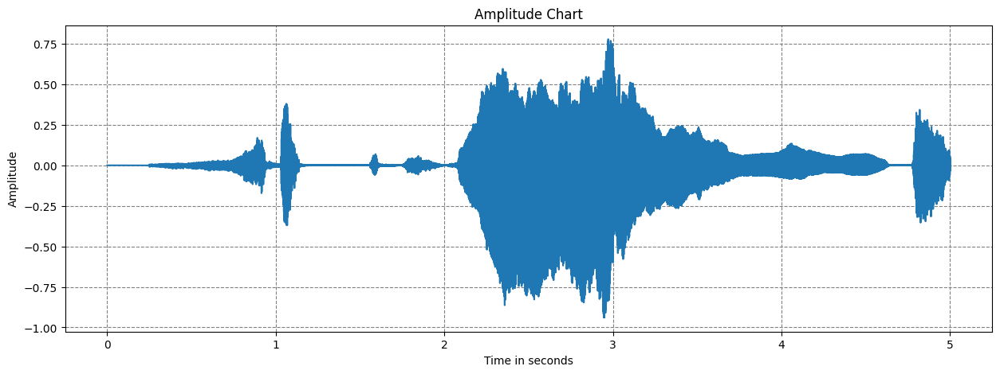

In [26]:
crying_baby1 = play_audio(1007)
amplitude(crying_baby1)

Audio file: 3-152007-B-20.wav
Category: crying_baby


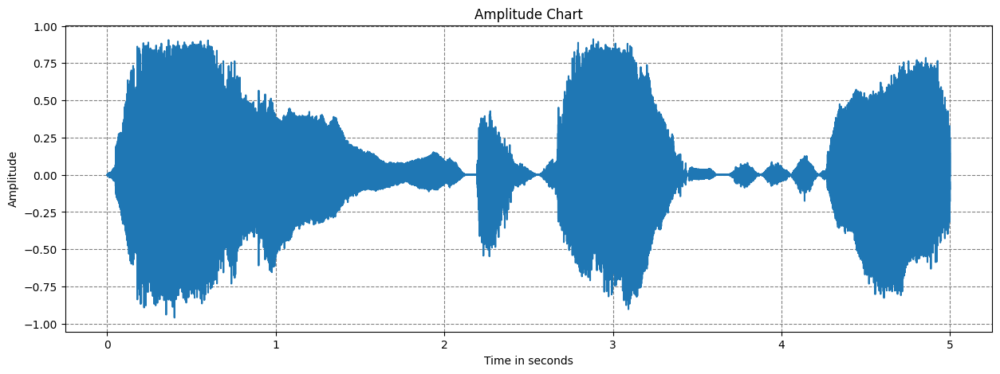

In [27]:
crying_baby2 = play_audio(1008)
amplitude(crying_baby2)

Audio file: 5-192191-A-19.wav
Category: thunderstorm


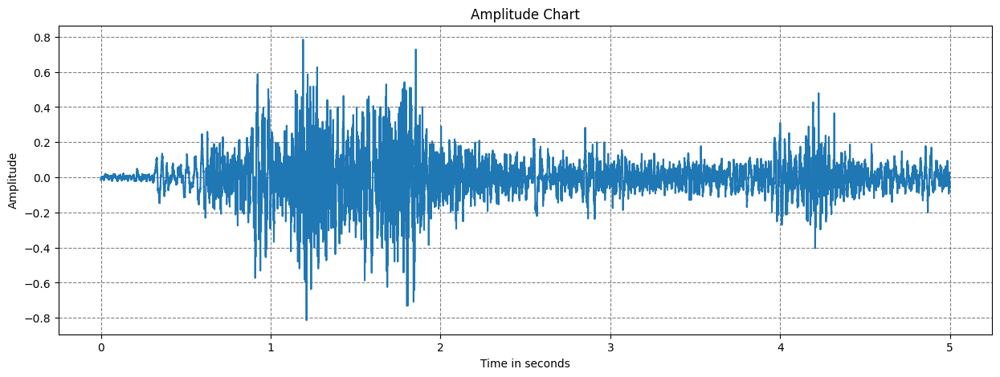

In [28]:
thunderstorm = play_audio(1700)
amplitude(thunderstorm)

### Embedding model

In [29]:
model = AudioTagging(
    checkpoint_path=None,
    device="cpu",
)
# change device to cpu or gpu

Checkpoint path: /home/azureuser/panns_data/Cnn14_mAP=0.431.pth
Using CPU.


In [30]:
crying_baby1_emb = get_sound_embedding(crying_baby1)
crying_baby1_emb.shape

(1, 2048)

In [31]:
crying_baby2_emb = get_sound_embedding(crying_baby2)
crying_baby2_emb.shape

(1, 2048)

In [32]:
thunder_emb = get_sound_embedding(thunderstorm)
thunder_emb.shape

(1, 2048)

In [33]:
def similarsound(emb1, emb2):
    """
    Cosine Similarity analysis
    """
    cosine = get_cosine_similarity(emb1, emb2)

    if cosine == 1:
        decision = "identical"
        color_code = "\033[1;31;34m"
    elif cosine >= 0.8:
        decision = "similar"
        color_code = "\033[1;31;32m"
    else:
        decision = "different"
        color_code = "\033[1;31;91m"

    print(f"{color_code}{decision.upper()} sound (cosine similarity = {cosine})")

In [34]:
similarsound(crying_baby1_emb, crying_baby1_emb)

IDENTICAL sound (cosine similarity = 1.0)


> Should have 1 because we are comparing the same embeddings

In [35]:
similarsound(crying_baby1_emb, crying_baby2_emb)

SIMILAR sound (cosine similarity = 0.8779551827614317)


> Should have a strong value because these 2 sounds are very similar

In [36]:
similarsound(thunder_emb, crying_baby1_emb)

DIFFERENT sound (cosine similarity = 0.42454024642101895)


> Value should be low

In [37]:
similarsound(thunder_emb, crying_baby2_emb)

DIFFERENT sound (cosine similarity = 0.4703236458815197)


> Value should be low

## 4. Audio Catalog

In [38]:
audio_catalog_df = pd.DataFrame(
    [
        (sound["filename"], sound["category"], sound["audio"]["array"])
        for sound in sounds_dataset
    ],
    columns=["audio_filename", "audio_category", "audio_array"],
)

In [39]:
audio_catalog_df

,audio_filename,audio_category,audio_array
0,1-100032-A-0.wav,dog,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,1-100038-A-14.wav,chirping_birds,"[-0.0118408203125, -0.103363037109375, -0.1414..."
2,1-100210-A-36.wav,vacuum_cleaner,"[-0.0069580078125, -0.01251220703125, -0.01126..."
3,1-100210-B-36.wav,vacuum_cleaner,"[0.538970947265625, 0.396270751953125, 0.26739..."
4,1-101296-A-19.wav,thunderstorm,"[-0.0003662109375, -0.000701904296875, -0.0007..."
...,...,...,...
1995,5-263831-B-6.wav,hen,"[-0.003387451171875, -0.0032958984375, -0.0032..."
1996,5-263902-A-36.wav,vacuum_cleaner,"[0.0655517578125, 0.011505126953125, -0.024536..."
1997,5-51149-A-25.wav,footsteps,"[-0.088714599609375, -0.07354736328125, -0.069..."
1998,5-61635-A-8.wav,sheep,"[-0.501800537109375, -0.22222900390625, 0.0527..."


In [40]:
audio_catalog_df.shape

(2000, 3)

In [41]:
audio_catalog_df["audio_category"].value_counts(sort=True)

audio_category
dog                 40
glass_breaking      40
drinking_sipping    40
rain                40
insects             40
laughing            40
hen                 40
engine              40
breathing           40
crying_baby         40
hand_saw            40
coughing            40
snoring             40
chirping_birds      40
toilet_flush        40
pig                 40
washing_machine     40
clock_tick          40
sneezing            40
rooster             40
sea_waves           40
siren               40
cat                 40
door_wood_creaks    40
helicopter          40
crackling_fire      40
car_horn            40
brushing_teeth      40
vacuum_cleaner      40
thunderstorm        40
door_wood_knock     40
can_opening         40
crow                40
clapping            40
fireworks           40
chainsaw            40
airplane            40
mouse_click         40
pouring_water       40
train               40
sheep               40
water_drops         40
church_bells       

## 5. Running the embeddings on each audio array

In [42]:
start = time.time()

print("Running the embeddings on all the audio files...")

# Applying the embedding function to the df
audio_catalog_df["audio_embeddings"] = audio_catalog_df["audio_array"].apply(
    get_sound_embedding
)

print("Done")
elapsed = time.time() - start
print(
    "Elapsed time: "
    + time.strftime(
        "%H:%M:%S.{}".format(str(elapsed % 1)[2:])[:15], time.gmtime(elapsed)
    )
)

Running the embeddings on all the audio files...
Done
Elapsed time: 00:01:49.233129


In [43]:
audio_catalog_df

,audio_filename,audio_category,audio_array,audio_embeddings
0,1-100032-A-0.wav,dog,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.0, 0.45767516, 0.0, 0.09763141, 0.0, 0.0, ..."
1,1-100038-A-14.wav,chirping_birds,"[-0.0118408203125, -0.103363037109375, -0.1414...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.71..."
2,1-100210-A-36.wav,vacuum_cleaner,"[-0.0069580078125, -0.01251220703125, -0.01126...","[[0.0, 0.26184928, 0.0, 0.0, 0.0, 0.0, 0.0, 0...."
3,1-100210-B-36.wav,vacuum_cleaner,"[0.538970947265625, 0.396270751953125, 0.26739...","[[0.0, 0.3977704, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0..."
4,1-101296-A-19.wav,thunderstorm,"[-0.0003662109375, -0.000701904296875, -0.0007...","[[0.0, 0.35427466, 0.0, 0.0, 0.0, 0.0, 0.0, 0...."
...,...,...,...,...
1995,5-263831-B-6.wav,hen,"[-0.003387451171875, -0.0032958984375, -0.0032...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.32989165, 0.0, 0...."
1996,5-263902-A-36.wav,vacuum_cleaner,"[0.0655517578125, 0.011505126953125, -0.024536...","[[0.0, 0.7369918, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0..."
1997,5-51149-A-25.wav,footsteps,"[-0.088714599609375, -0.07354736328125, -0.069...","[[0.0, 1.6351132, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0..."
1998,5-61635-A-8.wav,sheep,"[-0.501800537109375, -0.22222900390625, 0.0527...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [44]:
audio_catalog_df.shape

(2000, 4)

## 6. Azure Cognitive Search

In [45]:
index_name

'azure-audio-embeddings-demo'

In [46]:
delete_index(index_name)

Deleting the Azure Cognitive Search index: azure-audio-embeddings-demo
Done. Elapsed time: 0.63 secs


### Index definition

In [47]:
emb_length = 2048  # Dimension of the audio embeddings

In [48]:
try:
    # Setting the Azure Cognitive Search client
    print("Setting the Azure Cognitive Search client")
    search_client = SearchIndexClient(
        endpoint=acs_endpoint, credential=acs_cred
    )
    print("Done")
    print(search_client)

except:
    print("Request failed. Cannot create Azure Cognitive Search client:", acs_endpoint)

Setting the Azure Cognitive Search client
Done


In [49]:
start = time.time()

# Fields definition
fields = [
    # Sound id
    SimpleField(name="id_audiofile", type=SearchFieldDataType.String, key=True),
    
    # Sound filename
    SearchableField(
        name="audio_filename",
        type=SearchFieldDataType.String,
        searchable=True,
        retrievable=True,
    ),
    
    # Sound filename
    SearchableField(
        name="audio_category",
        type=SearchFieldDataType.String,
        searchable=True,
        retrievable=True,
    ),
    
    # Vector embedding
    SearchField(
        name="audio_embeddings",
        type=SearchFieldDataType.Collection(SearchFieldDataType.Single),
        searchable=True,
        dimensions=emb_length,  # Dimension of the audio embeddings
        vector_search_configuration="myconfig",
    ),
]

# Vector Search definition
vector_search = VectorSearch(
    algorithm_configurations=[
        VectorSearchAlgorithmConfiguration(
            name="myconfig",
            kind="hnsw",  # hnsw = Hierarchical Navigable Small Worlds
            hnsw_parameters={
                "m": 4,
                "efConstruction": 400,
                "efSearch": 1000,
                "metric": "cosine",  # Cosine similarity metric
            },
        )
    ]
)

# Semantic config
semantic_config = SemanticConfiguration(
    name="my-semantic-config",
    prioritized_fields=PrioritizedFields(
        title_field=SemanticField(field_name="id_audiofile"),
    ),
)

# Create the semantic settings with the configuration
semantic_settings = SemanticSettings(configurations=[semantic_config])

# Create the search index with the semantic settings
index = SearchIndex(
    name=index_name,
    fields=fields,
    vector_search=vector_search,
    semantic_settings=semantic_settings,
)

# Let's process
response = search_client.create_or_update_index(index)

print(f"Done. Search index {response.name} has been created.")
print("Elapsed time:", round(time.time() - start, 2), "secs")

Done. Search index azure-audio-embeddings-demo has been created.
Elapsed time: 0.88 secs


### Documents to load

In [50]:
documents_file = "documents.json"

In [51]:
if os.path.isfile(documents_file):
    os.remove(documents_file)

In [52]:
documents_df = audio_catalog_df.drop("audio_array", axis=1)
documents_df.loc[:, "audio_embeddings"] = documents_df["audio_embeddings"].apply(
    lambda x: x[0]
)
documents_df.loc[:, "id_audiofile"] = (documents_df.index + 1).astype(str)
column_order = ["id_audiofile", "audio_filename", "audio_category", "audio_embeddings"]
documents_df = documents_df[column_order]

documents_df.to_json(documents_file, orient="records")

In [53]:
documents_df

,id_audiofile,audio_filename,audio_category,audio_embeddings
0,1,1-100032-A-0.wav,dog,"[0.0, 0.45767516, 0.0, 0.09763141, 0.0, 0.0, 0..."
1,2,1-100038-A-14.wav,chirping_birds,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.717..."
2,3,1-100210-A-36.wav,vacuum_cleaner,"[0.0, 0.26184928, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0..."
3,4,1-100210-B-36.wav,vacuum_cleaner,"[0.0, 0.3977704, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,5,1-101296-A-19.wav,thunderstorm,"[0.0, 0.35427466, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0..."
...,...,...,...,...
1995,1996,5-263831-B-6.wav,hen,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.32989165, 0.0, 0.0..."
1996,1997,5-263902-A-36.wav,vacuum_cleaner,"[0.0, 0.7369918, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1997,1998,5-51149-A-25.wav,footsteps,"[0.0, 1.6351132, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1998,1999,5-61635-A-8.wav,sheep,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [54]:
with open(documents_file, "r") as file:
    documents = json.load(file)

len(documents)

2000

In [55]:
!ls $documents_file -lh

-rwxrwxrwx 1 root root 21M Jul 17 12:30 documents.json


### Loading the documents into the index

In [56]:
t1 = time.time()

idx = 0
total_nb = 0
step = 1
chunk_size = 500

while idx < len(documents):
    begin = idx
    end = begin + chunk_size
    print(step, "Loading the embeddings from", begin, "to", end)
    # Loading the chunck
    chunk_docs = documents[begin:end]
    # stats
    total_nb += loading_documents(chunk_docs)
    idx += chunk_size
    step += 1

print("Total number of loaded documents =", total_nb)
print("Elapsed time:", round(time.time() - t1, 2), "secs")

1 Loading the embeddings from 0 to 500
Uploading the documents into the index azure-audio-embeddings-demo ...

Done. Uploaded 500 documents into the Azure Cognitive Search index.

2 Loading the embeddings from 500 to 1000
Uploading the documents into the index azure-audio-embeddings-demo ...

Done. Uploaded 500 documents into the Azure Cognitive Search index.

3 Loading the embeddings from 1000 to 1500
Uploading the documents into the index azure-audio-embeddings-demo ...

Done. Uploaded 500 documents into the Azure Cognitive Search index.

4 Loading the embeddings from 1500 to 2000
Uploading the documents into the index azure-audio-embeddings-demo ...

Done. Uploaded 500 documents into the Azure Cognitive Search index.

Total number of loaded documents = 2000
Elapsed time: 18.61 secs


### Index information

In [57]:
index_status(index_name)

Azure Cognitive Search Index: azure-audio-embeddings-demo 


{
     "@odata.context": "https://azurecogsearcheastussr.search.windows.net/$metadata#indexes/$entity",
     "@odata.etag": "\"0x8DB86C19B2AA8AD\"",
     "name": "azure-audio-embeddings-demo",
     "defaultScoringProfile": null,
     "fields": [
          {
               "name": "id_audiofile",
               "type": "Edm.String",
               "searchable": false,
               "filterable": false,
               "retrievable": true,
               "sortable": false,
               "facetable": false,
               "key": true,
               "indexAnalyzer": null,
               "searchAnalyzer": null,
               "analyzer": null,
               "normalizer": null,
               "synonymMaps": []
          },
          {
               "name": "audio_filename",
               "type": "Edm.String",
               "searchable": true,
               "filterable": false,
               "retrievable": true,
            

In [137]:
document_count, storage_size = index_stats(index_name)

Azure Cognitive Search index status for: azure-audio-embeddings-demo

{
  "@odata.context": "https://azurecogsearcheastussr.search.windows.net/$metadata#Microsoft.Azure.Search.V2021_04_30_Preview.IndexStatistics",
  "documentCount": 2000,
  "storageSize": 39279810
}


In [138]:
print("Number of documents in the index =", f"{document_count:,}")
print("Size of the index =", round(storage_size / (1024 * 1024), 2), "MB")

Number of documents in the index = 2,000
Size of the index = 37.46 MB


## 7. Testing

In [60]:
search_client = SearchClient(acs_endpoint, index_name, acs_cred)

In [61]:
text = "cat"
print("Let's query the index with text =", text, "\n")

response = search_client.search(search_text=text)

for result in response:
    print("Id file:", result["id_audiofile"])
    print("Filename:", result["audio_filename"])
    print("Category:", result["audio_category"])
    print("Vector embedding size:", len(result["audio_embeddings"]))
    print()

Let's query the index with text = cat 

Id file: 979
Filename: 3-146965-A-5.wav
Category: cat
Vector embedding size: 2048

Id file: 177
Filename: 1-34094-B-5.wav
Category: cat
Vector embedding size: 2048

Id file: 1647
Filename: 5-172299-A-5.wav
Category: cat
Vector embedding size: 2048

Id file: 1189
Filename: 3-95694-A-5.wav
Category: cat
Vector embedding size: 2048

Id file: 1648
Filename: 5-172639-A-5.wav
Category: cat
Vector embedding size: 2048

Id file: 284
Filename: 1-56380-B-5.wav
Category: cat
Vector embedding size: 2048

Id file: 1243
Filename: 4-133047-A-5.wav
Category: cat
Vector embedding size: 2048

Id file: 176
Filename: 1-34094-A-5.wav
Category: cat
Vector embedding size: 2048

Id file: 692
Filename: 2-69131-A-5.wav
Category: cat
Vector embedding size: 2048

Id file: 232
Filename: 1-47819-C-5.wav
Category: cat
Vector embedding size: 2048

Id file: 757
Filename: 2-83934-A-5.wav
Category: cat
Vector embedding size: 2048

Id file: 1191
Filename: 3-95695-B-5.wav
Category: 

In [62]:
AUDIO_DIR = "audio"

os.makedirs(AUDIO_DIR, exist_ok=True)

### Car horn audio file

In [63]:
url = "https://github.com/retkowsky/Samples/raw/master/carhorn.wav"

downloaded_file = os.path.basename(url)
urllib.request.urlretrieve(url, downloaded_file)

('carhorn.wav', <http.client.HTTPMessage at 0x7ff06c802f20>)

In [64]:
Audio(downloaded_file, autoplay=True)

In [65]:
get_audio_metadata(downloaded_file)


 -------------------- Audio Statistics -------------------- 

Audio File:	 carhorn.wav
Modified Date:	 Mon Jul 17 12:31:35 2023
Creation Date:	 Mon Jul 17 12:31:35 2023
File Size:	 1330004
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 24
Bit Rate:	 2116800
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.026303854875284


In [66]:
sound_file = trim_audio(downloaded_file, 5000)
get_audio_metadata(sound_file)
os.remove(downloaded_file)

Initial length audio = 5026
Target duration is ms = 5000
New length audio = 5000

 -------------------- Audio Statistics -------------------- 

Audio File:	 audio/carhorn.wav
Modified Date:	 Mon Jul 17 12:31:42 2023
Creation Date:	 Mon Jul 17 12:31:42 2023
File Size:	 1764044
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 32
Bit Rate:	 2822400
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.0


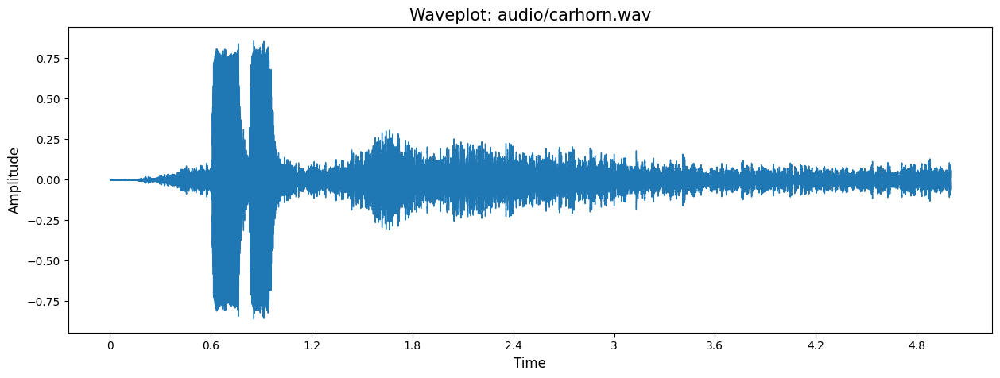

In [67]:
display_amplitude(sound_file)

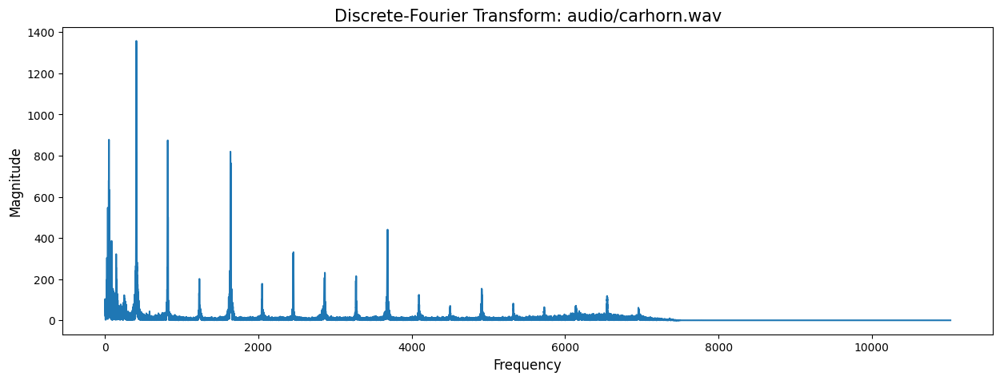

In [68]:
display_fft(sound_file)

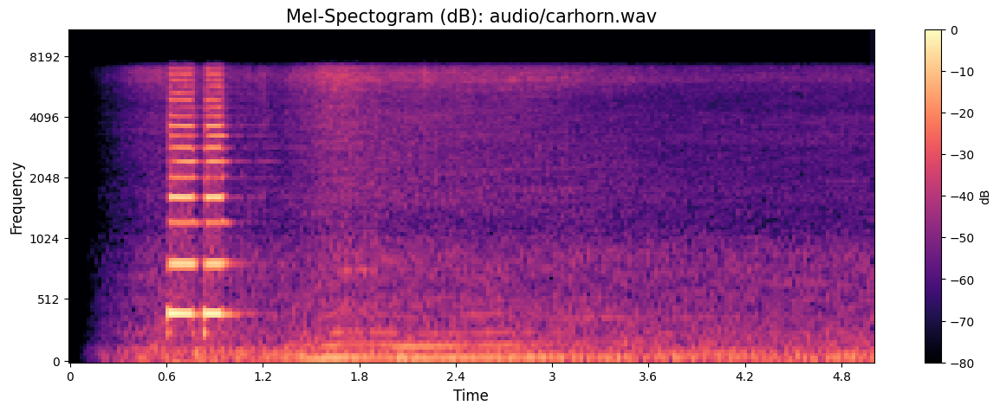

In [69]:
display_mel_spectogram(sound_file)

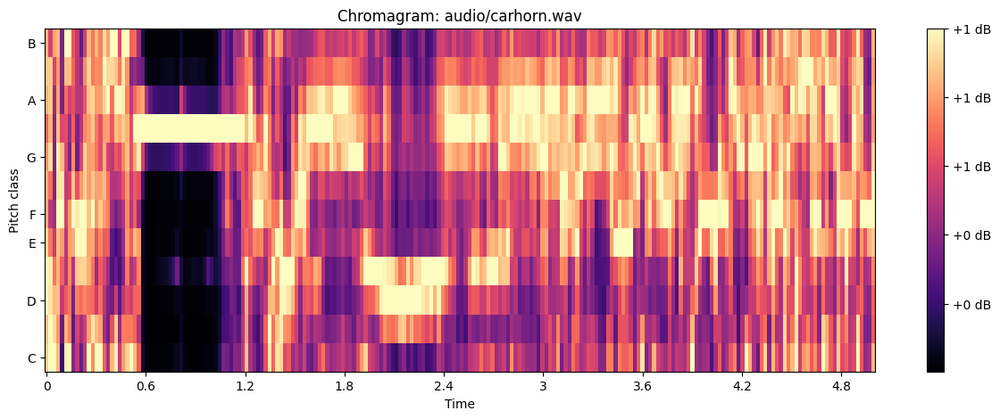

In [70]:
display_chromagram(sound_file)

In [71]:
topnlist = find_similar_sound(sound_file, topn=10)

Finding similar audio file of audio/carhorn.wav using audio embeddings and Azure Cognitive Search

Top 01: 4-176638-A-43.wav    | category: car_horn        | score = 0.93184865
Top 02: 5-180156-A-43.wav    | category: car_horn        | score = 0.9083259
Top 03: 3-155130-A-43.wav    | category: car_horn        | score = 0.9042427
Top 04: 4-175856-A-43.wav    | category: car_horn        | score = 0.89970815
Top 05: 4-175846-A-43.wav    | category: car_horn        | score = 0.87406135
Top 06: 4-176631-A-43.wav    | category: car_horn        | score = 0.87364113
Top 07: 4-175855-A-43.wav    | category: car_horn        | score = 0.8675966
Top 08: 2-125520-A-43.wav    | category: car_horn        | score = 0.8616989
Top 09: 5-179865-A-43.wav    | category: car_horn        | score = 0.85923207
Top 10: 1-28808-A-43.wav     | category: car_horn        | score = 0.8582286

Prediction (most common value) = car_horn

Done in 0.61559 seconds


In [72]:
play_audio_topn(0)

Audio file: 4-176638-A-43.wav
Category: car_horn


In [73]:
play_audio_topn(1)

Audio file: 5-180156-A-43.wav
Category: car_horn


In [74]:
play_audio_topn(2)

Audio file: 3-155130-A-43.wav
Category: car_horn


### Thunderstorm audio file

In [75]:
url = "https://github.com/retkowsky/Samples/raw/master/thunderstorm.wav"

downloaded_file = os.path.basename(url)
urllib.request.urlretrieve(url, downloaded_file)

('thunderstorm.wav', <http.client.HTTPMessage at 0x7ff1f816e320>)

In [76]:
Audio(downloaded_file, autoplay=True)

In [77]:
audio_file = get_audio_metadata(downloaded_file)


 -------------------- Audio Statistics -------------------- 

Audio File:	 thunderstorm.wav
Modified Date:	 Mon Jul 17 12:32:09 2023
Creation Date:	 Mon Jul 17 12:32:09 2023
File Size:	 1352324
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 24
Bit Rate:	 2116800
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.110430839002268


In [78]:
sound_file = trim_audio(downloaded_file, 5000)
get_audio_metadata(sound_file)
os.remove(downloaded_file)

Initial length audio = 5110
Target duration is ms = 5000
New length audio = 5000

 -------------------- Audio Statistics -------------------- 

Audio File:	 audio/thunderstorm.wav
Modified Date:	 Mon Jul 17 12:32:18 2023
Creation Date:	 Mon Jul 17 12:32:18 2023
File Size:	 1764044
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 32
Bit Rate:	 2822400
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.0


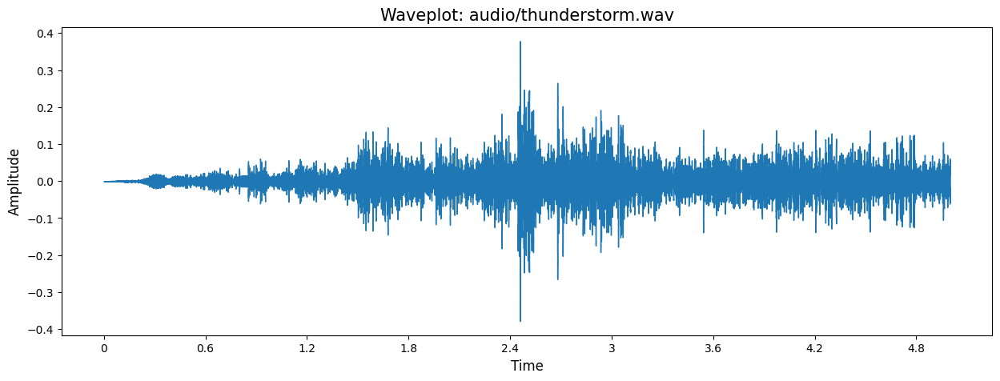

In [79]:
display_amplitude(sound_file)

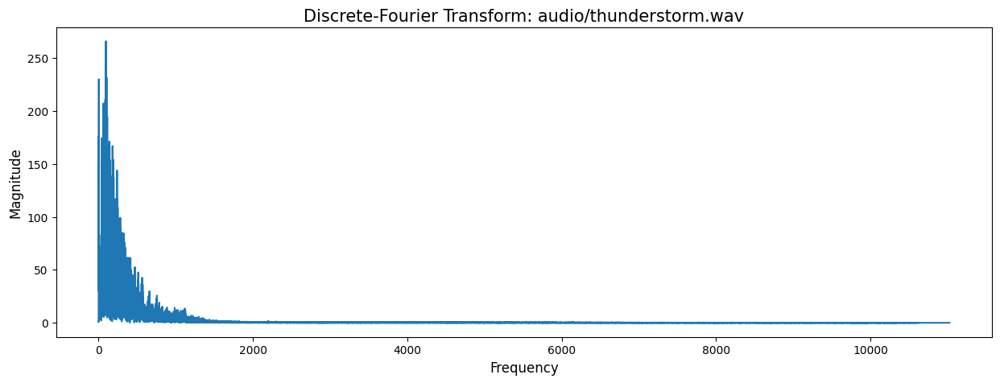

In [80]:
display_fft(sound_file)

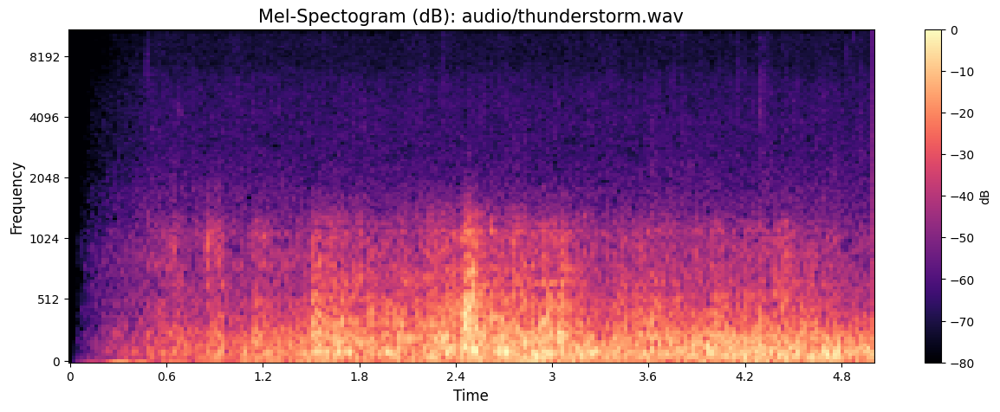

In [81]:
display_mel_spectogram(sound_file)

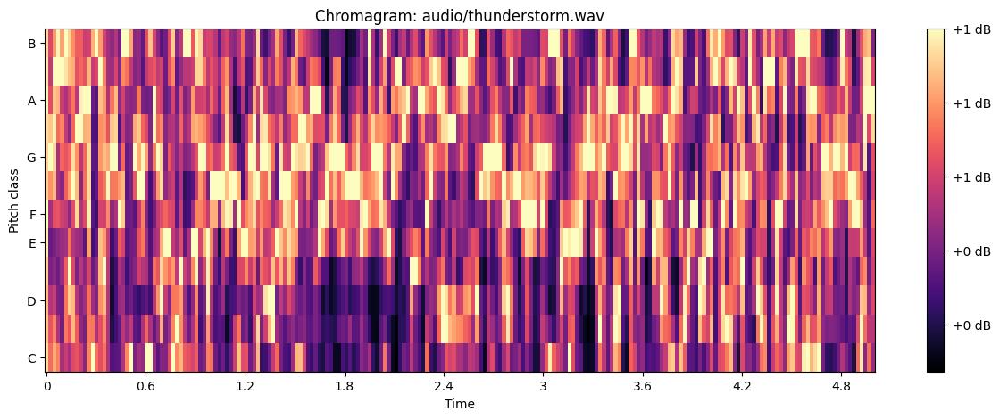

In [82]:
display_chromagram(sound_file)

In [83]:
topnlist = find_similar_sound(sound_file, topn=10)

Finding similar audio file of audio/thunderstorm.wav using audio embeddings and Azure Cognitive Search

Top 01: 3-144891-A-19.wav    | category: thunderstorm    | score = 0.9737588
Top 02: 3-124600-A-19.wav    | category: thunderstorm    | score = 0.9728228
Top 03: 2-104105-A-19.wav    | category: thunderstorm    | score = 0.96992326
Top 04: 2-104105-B-19.wav    | category: thunderstorm    | score = 0.9641213
Top 05: 2-39441-A-19.wav     | category: thunderstorm    | score = 0.9564175
Top 06: 5-192191-A-19.wav    | category: thunderstorm    | score = 0.95633376
Top 07: 4-125072-A-19.wav    | category: thunderstorm    | score = 0.95092005
Top 08: 1-101296-B-19.wav    | category: thunderstorm    | score = 0.9508249
Top 09: 3-103051-C-19.wav    | category: thunderstorm    | score = 0.94609135
Top 10: 4-165813-A-19.wav    | category: thunderstorm    | score = 0.9458554

Prediction (most common value) = thunderstorm

Done in 0.58304 seconds


In [84]:
play_audio_topn(0)

Audio file: 3-144891-A-19.wav
Category: thunderstorm


### Dog audio file

In [85]:
url = "https://github.com/retkowsky/Samples/raw/master/dog.wav"

downloaded_file = os.path.basename(url)
urllib.request.urlretrieve(url, downloaded_file)

('dog.wav', <http.client.HTTPMessage at 0x7ff1f9588f70>)

In [86]:
Audio(downloaded_file, autoplay=True)

In [87]:
get_audio_metadata(downloaded_file)


 -------------------- Audio Statistics -------------------- 

Audio File:	 dog.wav
Modified Date:	 Mon Jul 17 12:32:53 2023
Creation Date:	 Mon Jul 17 12:32:53 2023
File Size:	 1325878
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 24
Bit Rate:	 2116800
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.009478458049887


In [88]:
sound_file = trim_audio(downloaded_file, 5000)
get_audio_metadata(sound_file)
os.remove(downloaded_file)

Initial length audio = 5009
Target duration is ms = 5000
New length audio = 5000

 -------------------- Audio Statistics -------------------- 

Audio File:	 audio/dog.wav
Modified Date:	 Mon Jul 17 12:32:54 2023
Creation Date:	 Mon Jul 17 12:32:54 2023
File Size:	 1764044
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 32
Bit Rate:	 2822400
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.0


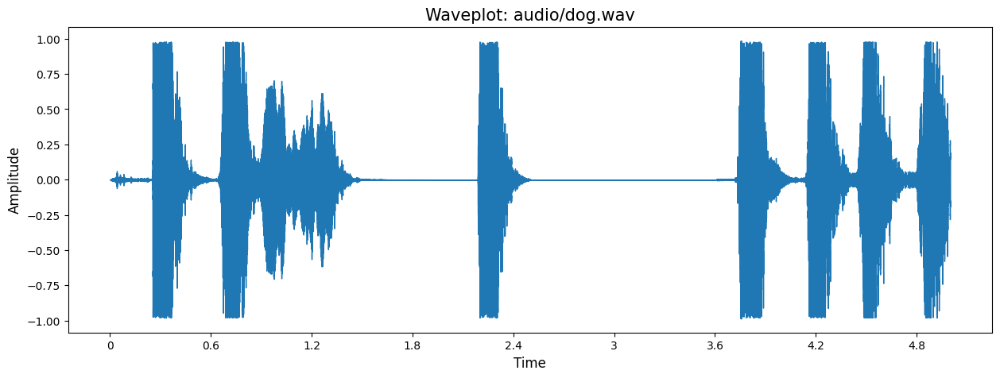

In [89]:
display_amplitude(sound_file)

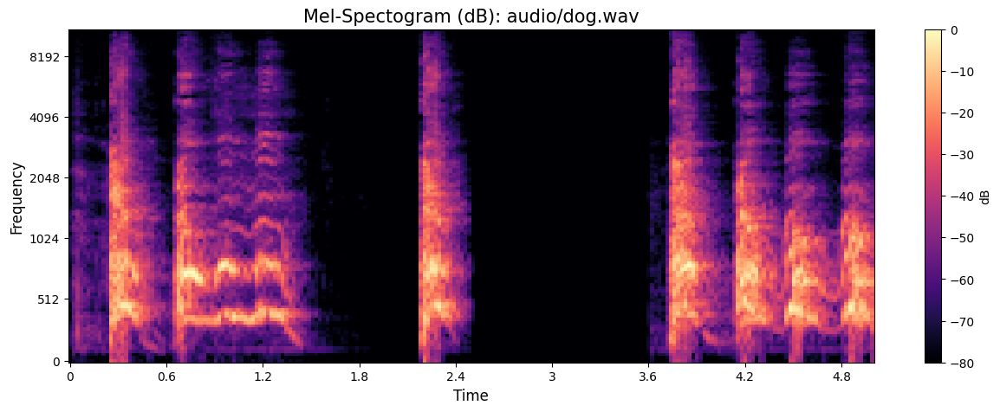

In [90]:
display_mel_spectogram(sound_file)

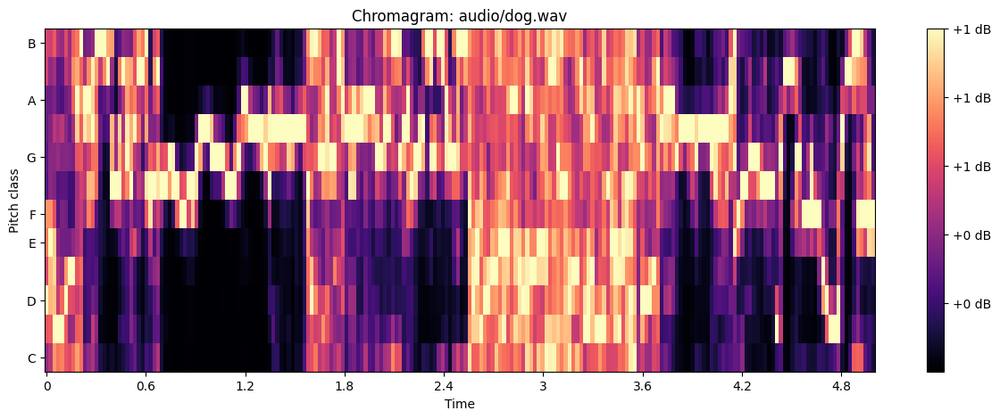

In [91]:
display_chromagram(sound_file)

In [92]:
topnlist = find_similar_sound(sound_file, topn=10)

Finding similar audio file of audio/dog.wav using audio embeddings and Azure Cognitive Search

Top 01: 1-59513-A-0.wav      | category: dog             | score = 0.9211199
Top 02: 5-203128-A-0.wav     | category: dog             | score = 0.9156356
Top 03: 4-199261-A-0.wav     | category: dog             | score = 0.9155764
Top 04: 2-122104-A-0.wav     | category: dog             | score = 0.9109588
Top 05: 2-116400-A-0.wav     | category: dog             | score = 0.90775454
Top 06: 1-30344-A-0.wav      | category: dog             | score = 0.90508664
Top 07: 2-122104-B-0.wav     | category: dog             | score = 0.9048793
Top 08: 1-32318-A-0.wav      | category: dog             | score = 0.9032055
Top 09: 4-192236-A-0.wav     | category: dog             | score = 0.9021781
Top 10: 2-117271-A-0.wav     | category: dog             | score = 0.9014561

Prediction (most common value) = dog

Done in 0.63285 seconds


In [93]:
play_audio_topn(0)

Audio file: 1-59513-A-0.wav
Category: dog


### Cat audio file

In [94]:
url = "https://github.com/retkowsky/Samples/raw/master/cat.wav"

downloaded_file = os.path.basename(url)
urllib.request.urlretrieve(url, downloaded_file)

('cat.wav', <http.client.HTTPMessage at 0x7ff1f80eb4f0>)

In [95]:
Audio(downloaded_file, autoplay=True)

In [96]:
get_audio_metadata(downloaded_file)


 -------------------- Audio Statistics -------------------- 

Audio File:	 cat.wav
Modified Date:	 Mon Jul 17 12:32:56 2023
Creation Date:	 Mon Jul 17 12:32:56 2023
File Size:	 215546
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 16
Bit Rate:	 256000
Sampling Rate:	 16000
Nb of Channels:	 1
Duration:	 6.731125


In [97]:
sound_file = trim_audio(downloaded_file, 5000)
get_audio_metadata(sound_file)
os.remove(downloaded_file)

Initial length audio = 6731
Target duration is ms = 5000
New length audio = 5000

 -------------------- Audio Statistics -------------------- 

Audio File:	 audio/cat.wav
Modified Date:	 Mon Jul 17 12:32:57 2023
Creation Date:	 Mon Jul 17 12:32:57 2023
File Size:	 160044
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 16
Bit Rate:	 256000
Sampling Rate:	 16000
Nb of Channels:	 1
Duration:	 5.0


In [98]:
y, sr = librosa.load(sound_file, sr=sr)
display(Audio(y, rate=sr))

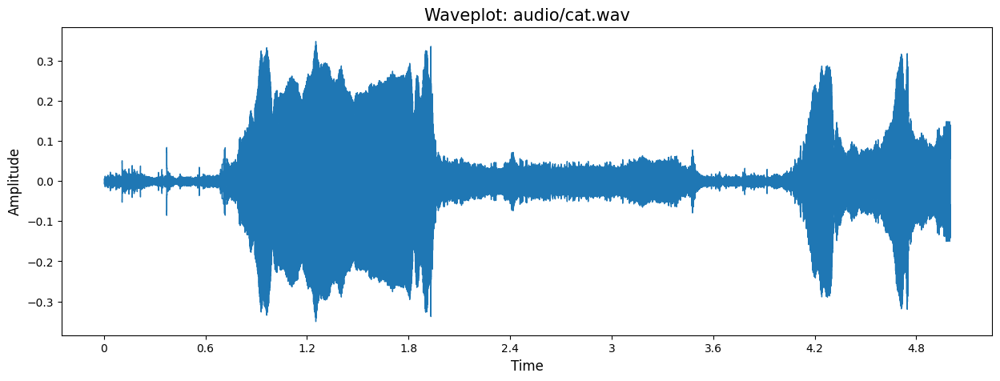

In [99]:
display_amplitude(sound_file)

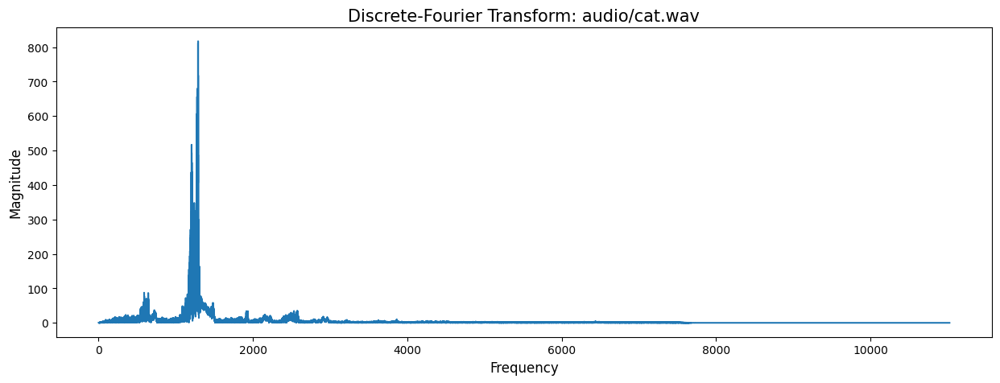

In [100]:
display_fft(sound_file)

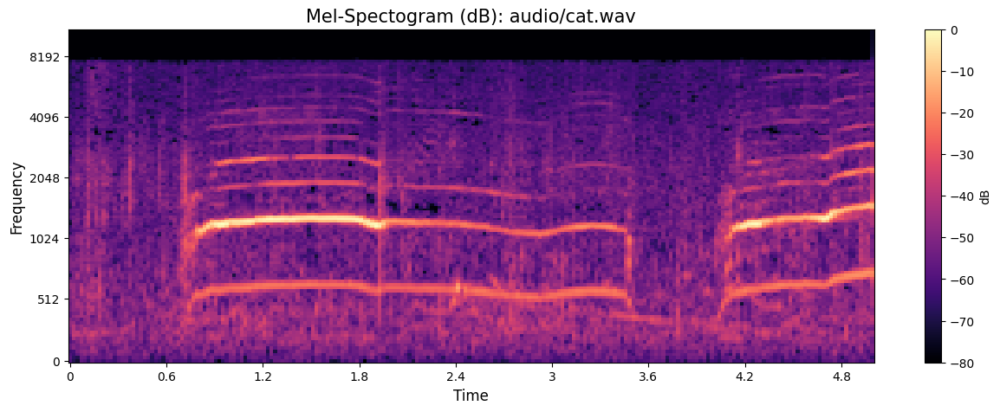

In [101]:
display_mel_spectogram(sound_file)

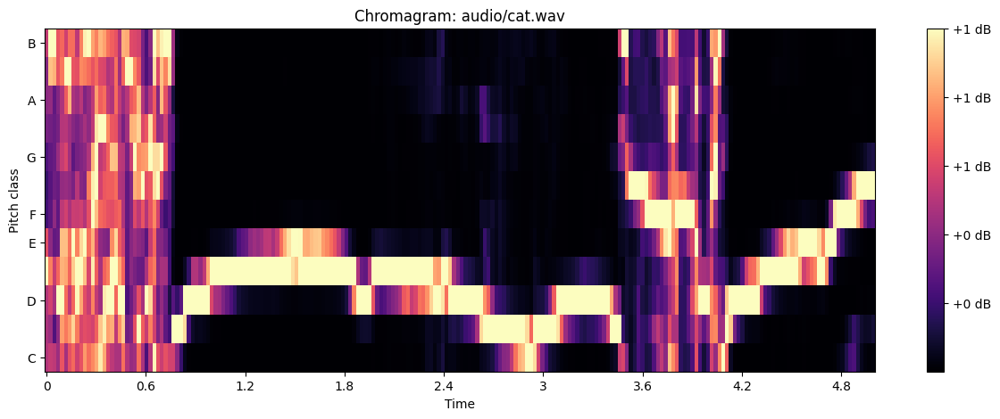

In [102]:
display_chromagram(sound_file)

In [103]:
topnlist = find_similar_sound(sound_file, topn=10)

Finding similar audio file of audio/cat.wav using audio embeddings and Azure Cognitive Search

Top 01: 1-34094-A-5.wav      | category: cat             | score = 0.87178624
Top 02: 3-95695-B-5.wav      | category: cat             | score = 0.8463432
Top 03: 5-172299-A-5.wav     | category: cat             | score = 0.8445713
Top 04: 2-50665-A-20.wav     | category: crying_baby     | score = 0.8364755
Top 05: 1-47819-B-5.wav      | category: cat             | score = 0.8331015
Top 06: 3-95695-A-5.wav      | category: cat             | score = 0.83107257
Top 07: 1-47819-A-5.wav      | category: cat             | score = 0.8291908
Top 08: 2-83934-A-5.wav      | category: cat             | score = 0.82688445
Top 09: 1-34094-B-5.wav      | category: cat             | score = 0.8221411
Top 10: 2-83934-B-5.wav      | category: cat             | score = 0.820438

Prediction (most common value) = cat

Done in 0.55755 seconds


In [104]:
play_audio_topn(0)

Audio file: 1-34094-A-5.wav
Category: cat


### Sea waves audio file

In [105]:
url = "https://github.com/retkowsky/Samples/raw/master/seawaves.wav"

downloaded_file = os.path.basename(url)
urllib.request.urlretrieve(url, downloaded_file)

('seawaves.wav', <http.client.HTTPMessage at 0x7ff0f8f93f10>)

In [106]:
Audio(downloaded_file, autoplay=True)

In [107]:
get_audio_metadata(downloaded_file)


 -------------------- Audio Statistics -------------------- 

Audio File:	 seawaves.wav
Modified Date:	 Mon Jul 17 12:32:59 2023
Creation Date:	 Mon Jul 17 12:32:59 2023
File Size:	 1332374
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 24
Bit Rate:	 2116800
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.035260770975056


In [108]:
sound_file = trim_audio(downloaded_file, 5000)
get_audio_metadata(sound_file)
os.remove(downloaded_file)

Initial length audio = 5035
Target duration is ms = 5000
New length audio = 5000

 -------------------- Audio Statistics -------------------- 

Audio File:	 audio/seawaves.wav
Modified Date:	 Mon Jul 17 12:33:00 2023
Creation Date:	 Mon Jul 17 12:33:00 2023
File Size:	 1764044
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 32
Bit Rate:	 2822400
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.0


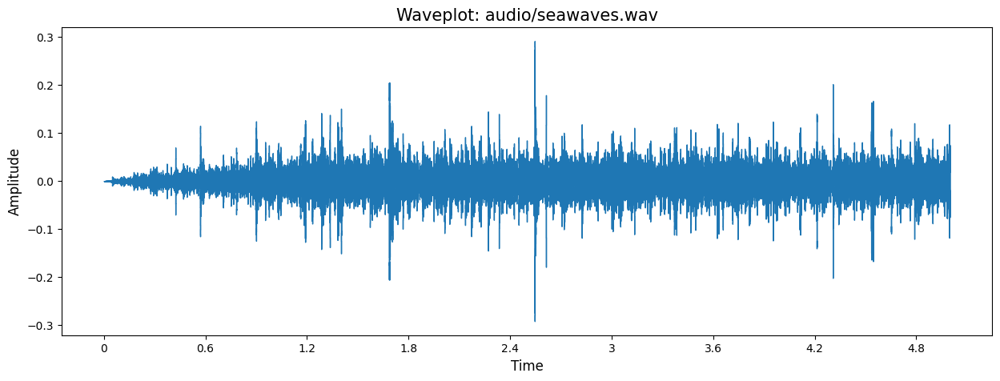

In [109]:
display_amplitude(sound_file)

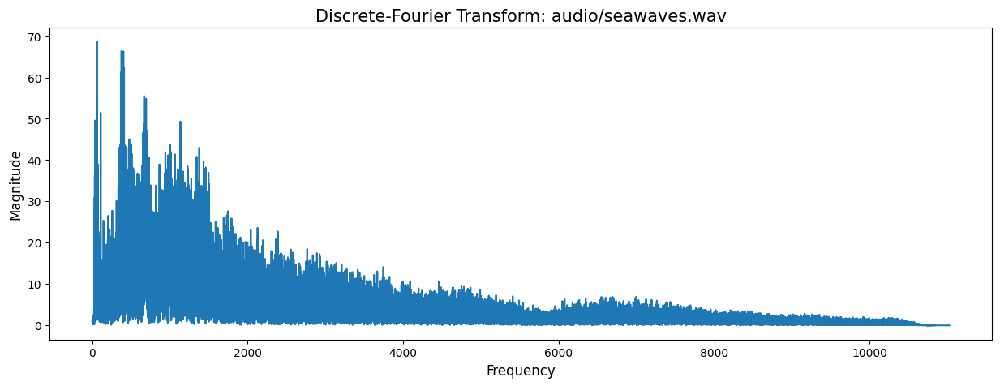

In [110]:
display_fft(sound_file)

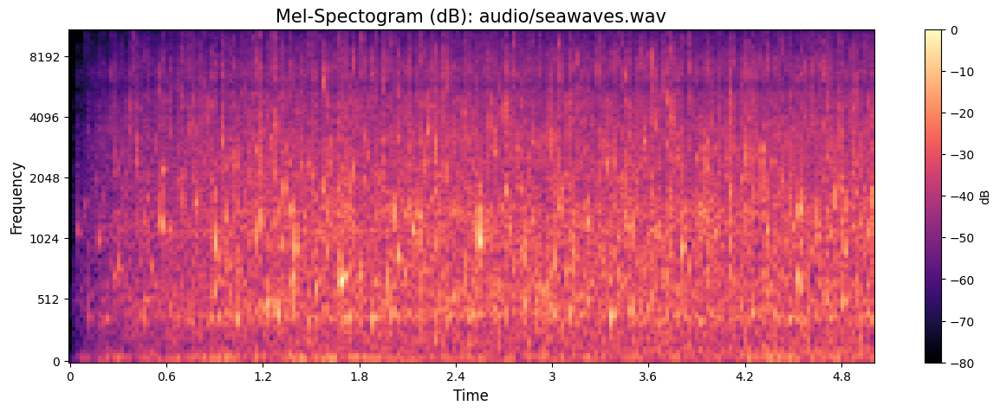

In [111]:
display_mel_spectogram(sound_file)

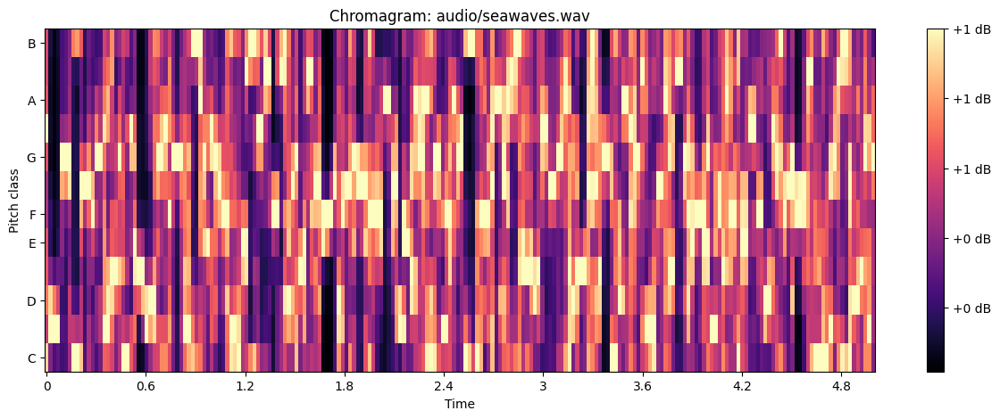

In [112]:
display_chromagram(sound_file)

In [113]:
topnlist = find_similar_sound(sound_file, topn=10)

Finding similar audio file of audio/seawaves.wav using audio embeddings and Azure Cognitive Search

Top 01: 2-125966-A-11.wav    | category: sea_waves       | score = 0.96979314
Top 02: 1-39901-A-11.wav     | category: sea_waves       | score = 0.94398475
Top 03: 1-43760-A-11.wav     | category: sea_waves       | score = 0.936552
Top 04: 3-164630-A-11.wav    | category: sea_waves       | score = 0.9279996
Top 05: 2-102852-A-11.wav    | category: sea_waves       | score = 0.8956395
Top 06: 2-67422-A-18.wav     | category: toilet_flush    | score = 0.8841774
Top 07: 1-39901-B-11.wav     | category: sea_waves       | score = 0.8691609
Top 08: 1-17742-A-12.wav     | category: crackling_fire  | score = 0.8661907
Top 09: 3-98771-A-18.wav     | category: toilet_flush    | score = 0.8645
Top 10: 4-218199-E-35.wav    | category: washing_machine | score = 0.8618193

Prediction (most common value) = sea_waves

Done in 0.56789 seconds


In [114]:
play_audio_topn(0)

Audio file: 2-125966-A-11.wav
Category: sea_waves


### Airplane audio file

In [115]:
url = "https://github.com/retkowsky/Samples/raw/master/airplane.wav"

downloaded_file = os.path.basename(url)
urllib.request.urlretrieve(url, downloaded_file)

('airplane.wav', <http.client.HTTPMessage at 0x7ff0f8a1b070>)

In [116]:
get_audio_metadata(downloaded_file)


 -------------------- Audio Statistics -------------------- 

Audio File:	 airplane.wav
Modified Date:	 Mon Jul 17 12:33:03 2023
Creation Date:	 Mon Jul 17 12:33:03 2023
File Size:	 1342130
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 24
Bit Rate:	 2116800
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.072131519274376


In [117]:
sound_file = trim_audio(downloaded_file, 5000)
get_audio_metadata(sound_file)
os.remove(downloaded_file)

Initial length audio = 5072
Target duration is ms = 5000
New length audio = 5000

 -------------------- Audio Statistics -------------------- 

Audio File:	 audio/airplane.wav
Modified Date:	 Mon Jul 17 12:33:04 2023
Creation Date:	 Mon Jul 17 12:33:04 2023
File Size:	 1764044
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 32
Bit Rate:	 2822400
Sampling Rate:	 44100
Nb of Channels:	 2
Duration:	 5.0


In [118]:
y, sr = librosa.load(sound_file, sr=sr)
display(Audio(y, rate=sr))

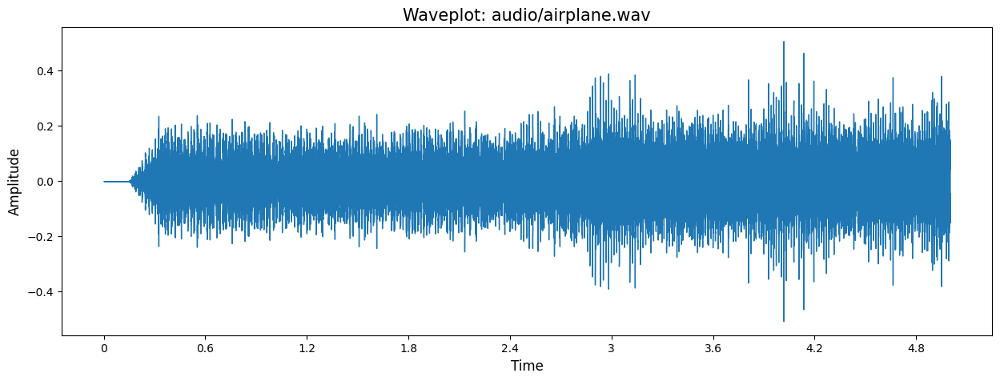

In [119]:
display_amplitude(sound_file)

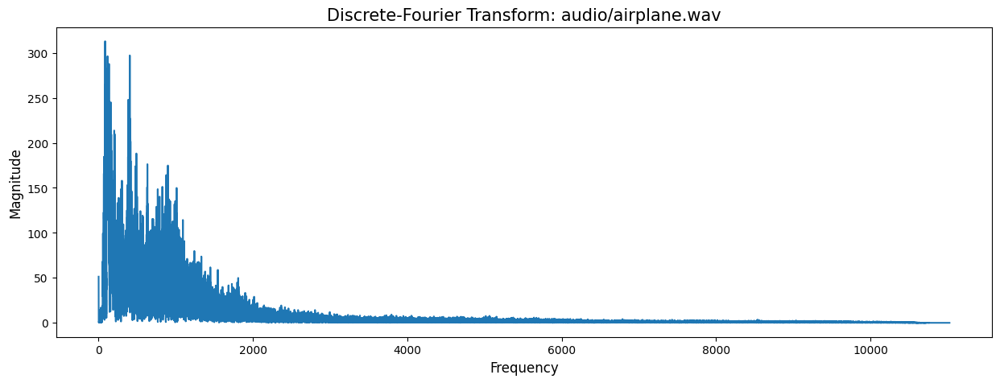

In [120]:
display_fft(sound_file)

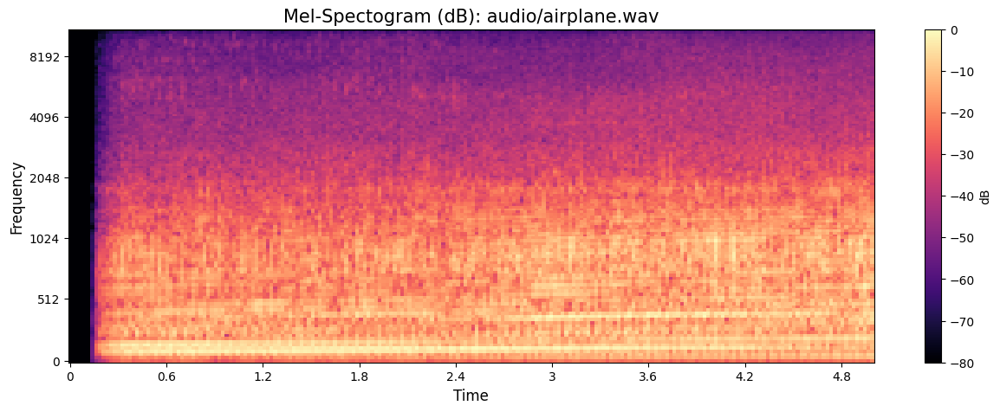

In [121]:
display_mel_spectogram(sound_file)

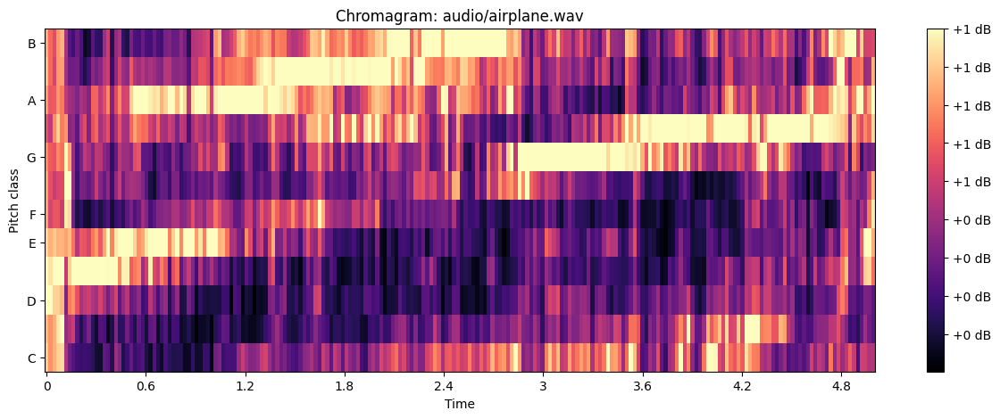

In [122]:
display_chromagram(sound_file)

In [123]:
topnlist = find_similar_sound(sound_file, topn=10)

Finding similar audio file of audio/airplane.wav using audio embeddings and Azure Cognitive Search

Top 01: 3-154926-B-40.wav    | category: helicopter      | score = 0.90285325
Top 02: 4-161103-A-47.wav    | category: airplane        | score = 0.89275604
Top 03: 3-143562-A-47.wav    | category: airplane        | score = 0.88806623
Top 04: 4-161100-A-47.wav    | category: airplane        | score = 0.8857095
Top 05: 1-53467-A-47.wav     | category: airplane        | score = 0.877375
Top 06: 2-37806-A-40.wav     | category: helicopter      | score = 0.8771628
Top 07: 4-161105-A-47.wav    | category: airplane        | score = 0.8733919
Top 08: 3-143560-A-47.wav    | category: airplane        | score = 0.87320745
Top 09: 3-159346-B-36.wav    | category: vacuum_cleaner  | score = 0.87229216
Top 10: 4-161105-B-47.wav    | category: airplane        | score = 0.87216747

Prediction (most common value) = airplane

Done in 0.57069 seconds


In [124]:
play_audio_topn(0)

Audio file: 3-154926-B-40.wav
Category: helicopter


### Keyboard typying audio file

In [125]:
url = "https://github.com/retkowsky/Samples/raw/master/keyboard.wav"

downloaded_file = os.path.basename(url)
urllib.request.urlretrieve(url, downloaded_file)

('keyboard.wav', <http.client.HTTPMessage at 0x7ff0f8648a00>)

In [126]:
Audio(downloaded_file, autoplay=True)

In [127]:
get_audio_metadata(downloaded_file)


 -------------------- Audio Statistics -------------------- 

Audio File:	 keyboard.wav
Modified Date:	 Mon Jul 17 12:33:14 2023
Creation Date:	 Mon Jul 17 12:33:14 2023
File Size:	 1914728
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 24
Bit Rate:	 2304000
Sampling Rate:	 48000
Nb of Channels:	 2
Duration:	 6.648


In [128]:
sound_file = trim_audio(downloaded_file, 5000)
get_audio_metadata(sound_file)
os.remove(downloaded_file)

Initial length audio = 6648
Target duration is ms = 5000
New length audio = 5000

 -------------------- Audio Statistics -------------------- 

Audio File:	 audio/keyboard.wav
Modified Date:	 Mon Jul 17 12:33:15 2023
Creation Date:	 Mon Jul 17 12:33:15 2023
File Size:	 1920044
Audio Format:	 WAVEAudioFormat.PCM
Bit Depth:	 32
Bit Rate:	 3072000
Sampling Rate:	 48000
Nb of Channels:	 2
Duration:	 5.0


In [129]:
y, sr = librosa.load(sound_file, sr=sr)
display(Audio(y, rate=sr))

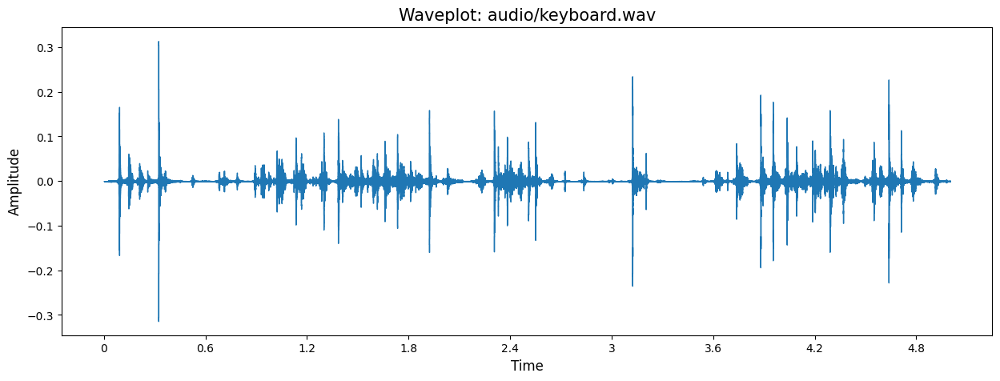

In [130]:
display_amplitude(sound_file)

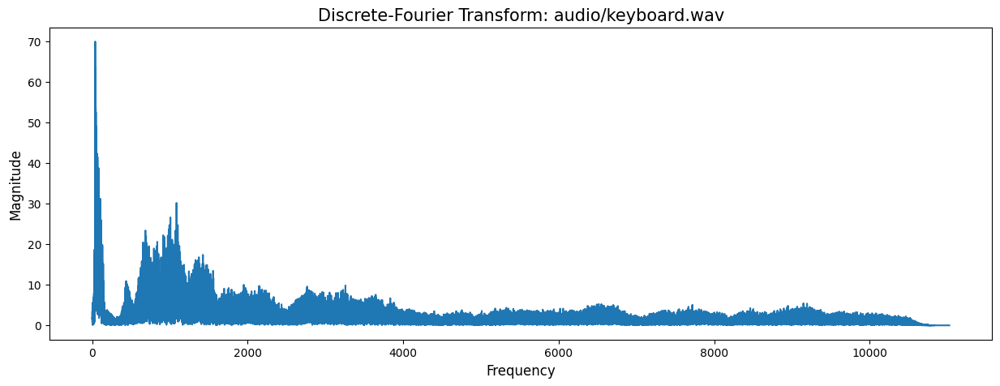

In [131]:
display_fft(sound_file)

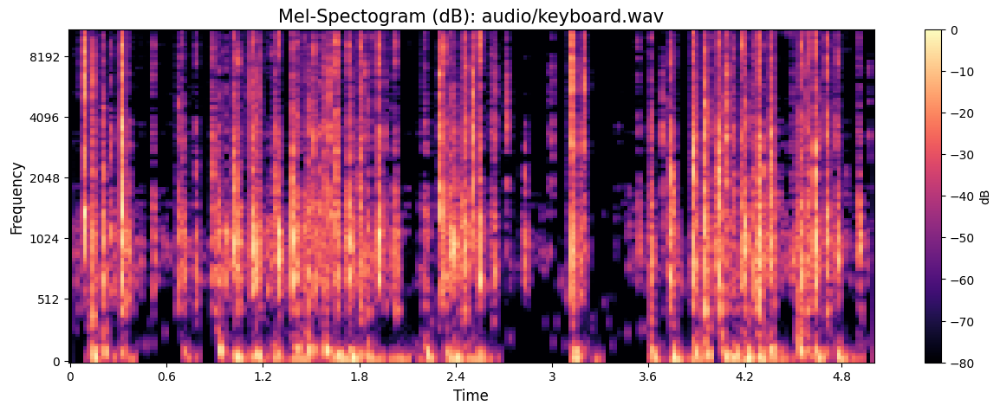

In [132]:
display_mel_spectogram(sound_file)

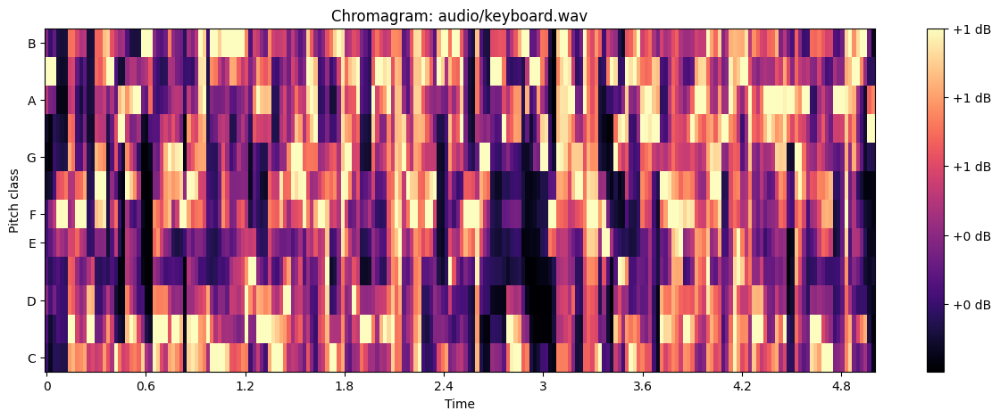

In [133]:
display_chromagram(sound_file)

In [134]:
topnlist = find_similar_sound(sound_file, topn=10)

Finding similar audio file of audio/keyboard.wav using audio embeddings and Azure Cognitive Search

Top 01: 5-222894-A-32.wav    | category: keyboard_typing | score = 0.95862454
Top 02: 3-154781-A-32.wav    | category: keyboard_typing | score = 0.9566262
Top 03: 4-181707-A-32.wav    | category: keyboard_typing | score = 0.95360094
Top 04: 3-155570-A-32.wav    | category: keyboard_typing | score = 0.9530303
Top 05: 3-132830-A-32.wav    | category: keyboard_typing | score = 0.9525628
Top 06: 1-137-A-32.wav       | category: keyboard_typing | score = 0.9504803
Top 07: 2-109316-A-32.wav    | category: keyboard_typing | score = 0.9449672
Top 08: 2-104168-A-32.wav    | category: keyboard_typing | score = 0.9421257
Top 09: 4-167155-A-32.wav    | category: keyboard_typing | score = 0.93862355
Top 10: 1-84393-A-32.wav     | category: keyboard_typing | score = 0.9374637

Prediction (most common value) = keyboard_typing

Done in 0.56372 seconds


In [135]:
play_audio_topn(0)

Audio file: 5-222894-A-32.wav
Category: keyboard_typing


## 8. Post Processing

We can delete the Azure Cognitive Search index if needed

In [136]:
index_status(index_name)

Azure Cognitive Search Index: azure-audio-embeddings-demo 


{
     "@odata.context": "https://azurecogsearcheastussr.search.windows.net/$metadata#indexes/$entity",
     "@odata.etag": "\"0x8DB86C19B2AA8AD\"",
     "name": "azure-audio-embeddings-demo",
     "defaultScoringProfile": null,
     "fields": [
          {
               "name": "id_audiofile",
               "type": "Edm.String",
               "searchable": false,
               "filterable": false,
               "retrievable": true,
               "sortable": false,
               "facetable": false,
               "key": true,
               "indexAnalyzer": null,
               "searchAnalyzer": null,
               "analyzer": null,
               "normalizer": null,
               "synonymMaps": []
          },
          {
               "name": "audio_filename",
               "type": "Edm.String",
               "searchable": true,
               "filterable": false,
               "retrievable": true,
            

In [139]:
delete_index(index_name)

Deleting the Azure Cognitive Search index: azure-audio-embeddings-demo
Done. Elapsed time: 0.64 secs


In [140]:
index_status(index_name)

Azure Cognitive Search Index: azure-audio-embeddings-demo 


{
     "error": {
          "code": "",
          "message": "No index with the name 'azure-audio-embeddings-demo' was found in the service 'azurecogsearcheastussr'."
     }
}
